In [20]:
import os
import torch
import torch.nn as nn
import torchvision.models as models
from torchvision import transforms
from PIL import Image
import numpy as np
from tqdm.notebook import tqdm
from sklearn.metrics import confusion_matrix, precision_
from IPython.display import display

from src.data_loader import read_dataset, get_loader
from facenet_pytorch import InceptionResnetV1, fixed_image_standardization
import numpy as np

In [23]:
class FaceRecognitionCNN(nn.Module):
    def __init__(self):
        super(FaceRecognitionCNN, self).__init__()
        self.resnet = InceptionResnetV1(pretrained='vggface2')
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(512, 1)

    def forward(self, images):
        out = self.resnet(images)
        out = self.relu(out)
        out = self.dropout(out)
        out = self.fc(out)
        return out.squeeze()

In [3]:
class ClassificationCNN(nn.Module):
    def __init__(self):
        super(ClassificationCNN, self).__init__()
        resnet = models.resnet18(pretrained=False)

        final_hidden_dim = 256
        resnet.fc = nn.Linear(512, final_hidden_dim)

        self.model = nn.Sequential(
            resnet,
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(final_hidden_dim, 1)
        )

    def forward(self, images):
        return self.model(images).squeeze()

In [24]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cpu')

In [5]:
model_dir = '/home/nika/Desktop/DeepFaceForgeryDetection/cloud_models/Jan11_20-35-47_gpu-training/'

In [30]:
model = FaceRecognitionCNN()
state_dict = torch.load(os.path.join(model_dir, 'model.pt'), map_location=device)
model.load_state_dict(state_dict)
model.eval();

# Image preprocessing, normalization for the pretrained resnet
transform = transforms.Compose([
    transforms.Resize((160, 160)),
    np.float32,
    transforms.ToTensor(),
    fixed_image_standardization
])

In [ ]:
model = ClassificationCNN()
state_dict = torch.load(os.path.join(model_dir, 'model.pt'), map_location=device)
model.load_state_dict(state_dict)
model.eval();

# Image preprocessing, normalization for the pretrained resnet
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
])

In [44]:
_, val_dataset = read_dataset(
    '/home/nika/Desktop/FaceForensics/original', '/home/nika/Desktop/FaceForensics/neural_textures/',
    transform=transform, max_images_per_video=50, splits_path='dataset/splits', window_size=1
)

print(f'validation data size: {len(val_dataset)}')

val_loader = get_loader(
    val_dataset, batch_size=64, shuffle=False, num_workers=4
)

validation data size: 10500


In [45]:
all_predictions = []
all_targets = []
all_video_ids = []

with torch.no_grad():
    for video_ids, images, targets in tqdm(val_loader):
        images = images.to(device)
        targets = targets.to(device)

        outputs = model(images)
        predictions = outputs > 0.0
        all_predictions.append(predictions)
        all_targets.append(targets)
        all_video_ids.append(video_ids)

all_predictions = torch.cat(all_predictions)
all_targets = torch.cat(all_targets)
all_video_ids = torch.cat(all_video_ids)

In [46]:
all_predictions.shape

torch.Size([10496])

In [48]:
(all_predictions[1:] == all_predictions[:-1]).sum().float() / all_predictions.shape[0]

tensor(0.9176)

In [49]:
set(all_video_ids.tolist())

{4,
 23,
 42,
 46,
 64,
 84,
 91,
 104,
 106,
 115,
 116,
 126,
 134,
 145,
 157,
 159,
 175,
 192,
 198,
 223,
 245,
 254,
 261,
 263,
 273,
 284,
 299,
 316,
 325,
 342,
 349,
 350,
 354,
 362,
 364,
 369,
 370,
 402,
 416,
 419,
 440,
 443,
 453,
 455,
 465,
 468,
 470,
 471,
 472,
 482,
 483,
 492,
 493,
 511,
 514,
 538,
 548,
 557,
 558,
 560,
 564,
 565,
 566,
 567,
 571,
 583,
 584,
 585,
 586,
 589,
 595,
 597,
 599,
 606,
 612,
 617,
 622,
 632,
 638,
 640,
 647,
 649,
 656,
 664,
 666,
 668,
 672,
 702,
 720,
 727,
 729,
 742,
 745,
 746,
 762,
 768,
 775,
 777,
 779,
 793,
 794,
 807,
 816,
 817,
 818,
 820,
 823,
 824,
 827,
 832,
 834,
 837,
 852,
 857,
 875,
 890,
 895,
 898,
 900,
 904,
 909,
 912,
 915,
 922,
 923,
 925,
 926,
 927,
 933,
 939,
 947,
 951,
 956,
 958,
 971,
 979,
 980,
 982,
 991,
 992,
 4982,
 23923,
 42084,
 91116,
 104126,
 106198,
 157245,
 159175,
 192134,
 261254,
 273807,
 284263,
 299145,
 316369,
 325492,
 350349,
 362354,
 402453,
 416342,
 4

In [50]:
# All misclassified video ids
set(all_video_ids[~(all_predictions == all_targets)].tolist())

{23,
 42,
 84,
 91,
 104,
 115,
 157,
 175,
 254,
 284,
 325,
 354,
 369,
 402,
 416,
 440,
 453,
 465,
 468,
 470,
 471,
 472,
 483,
 557,
 560,
 564,
 565,
 566,
 571,
 583,
 589,
 595,
 597,
 606,
 612,
 622,
 632,
 640,
 702,
 720,
 729,
 742,
 807,
 816,
 827,
 832,
 834,
 890,
 895,
 898,
 900,
 904,
 915,
 926,
 939,
 947,
 958,
 971,
 982,
 4982,
 23923,
 42084,
 91116,
 104126,
 106198,
 192134,
 261254,
 273807,
 284263,
 299145,
 316369,
 325492,
 350349,
 362354,
 402453,
 416342,
 419824,
 440364,
 443514,
 465482,
 471455,
 472511,
 483370,
 493538,
 566617,
 571746,
 583558,
 586223,
 599585,
 632548,
 640638,
 647622,
 656666,
 664668,
 702612,
 727729,
 742775,
 745777,
 762832,
 793768,
 820818,
 823584,
 837890,
 857909,
 904046,
 915895,
 922898,
 926900,
 927912,
 933925,
 939115,
 947951,
 958956,
 971564,
 979875,
 991064,
 992980}

In [51]:
all_predictions.shape, all_targets.shape

(torch.Size([10496]), torch.Size([10496]))

In [52]:
confusion_matrix(all_predictions, all_targets)

array([[6362, 1704],
       [ 634, 1796]])

In [53]:
tn, fp, fn, tp = confusion_matrix(all_predictions, all_targets).ravel()
tn, fp, fn, tp

(6362, 1704, 634, 1796)

In [62]:
total = float(tn + fp + fn + tp)
accuracy = (tp + tn) / total
precision = tp / (tp + fp)
recall = tp / (tp + fn)
print('accuracy', accuracy)
print('precision', precision)
print('recall', recall)

accuracy 0.7772484756097561
precision 0.5131428571428571
recall 0.7390946502057614


In [64]:
tp / (tp + fp)

0.5131428571428571

In [65]:
tn / (tn + fn)

0.9093767867352773

In [16]:
incorrect_labels = []
for index, (pred, target) in enumerate(zip(all_predictions, all_targets)):
    if pred != target:
        incorrect_labels.append((index, pred, target))

In [56]:
all_targets

tensor([1., 1., 1.,  ..., 0., 0., 0.])

In [55]:
all_predictions.int()

tensor([0, 0, 0,  ..., 0, 0, 0], dtype=torch.int32)

In [24]:
_, val_dataset = read_dataset(
    'dataset/images_large/original', 'dataset/images_large/tampered', transform=None,
    max_images_per_video=999999, splits_path='dataset/splits'
)

def display_sample(label_index):
    img_index, pred, target = incorrect_labels[label_index]
    print('label_index: {}, pred: {}, target: {}'.format(label_index, pred, target))
    return val_dataset[img_index][0]

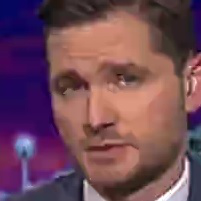

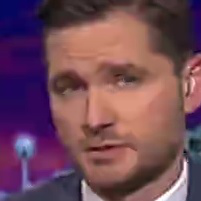

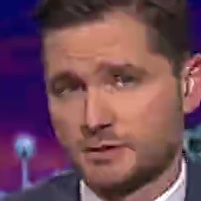

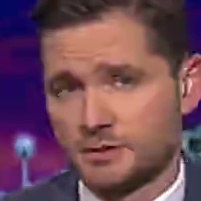

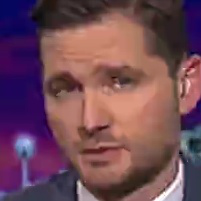

...

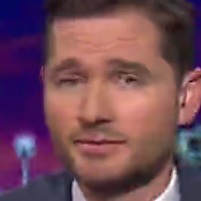

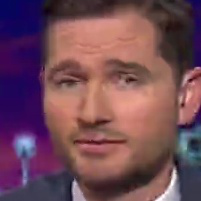

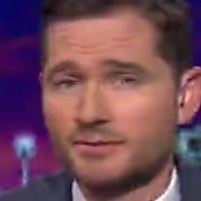

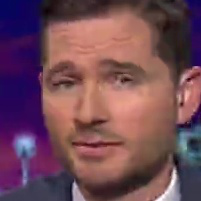

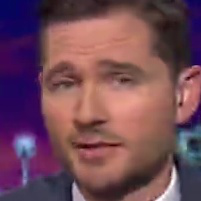

In [26]:
display(*[x[0] for x in val_dataset][:-100])

In [73]:
y_pred = torch.Tensor([0])
y_true = torch.Tensor([1.])
nn.BCELoss()(y_pred, y_true)

tensor(27.6310)

$$
        \ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad
        l_n = - w_n \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]
$$

In [33]:
images.shape, targets.shape

(torch.Size([1, 3, 224, 224]), torch.Size([1]))

In [34]:
targets

tensor([0.])

In [62]:
with torch.no_grad():
    scores = model(images)

In [44]:
nn.Sigmoid()(scores)

tensor(0.0183)

In [45]:
img = images[0]

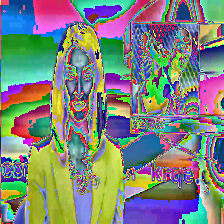

In [46]:
reverse_transform = transforms.Compose([
    transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225], std=[1/0.229, 1/0.224, 1/0.255]),
    transforms.ToPILImage()
])


transforms.ToPILImage()(img)

In [17]:
_, val_dataset = read_dataset(
    'dataset/images_large/original', 'dataset/images_large/tampered', transform=None,
    max_images_per_video=999999, splits_path='dataset/splits'
)
img = val_dataset[0][0]

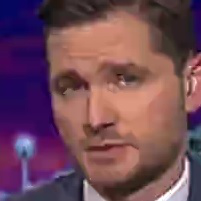

In [18]:
img

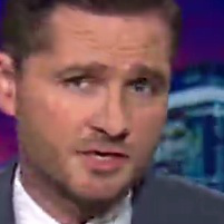

In [50]:
transforms.Resize((224, 224))(img)

In [50]:
img = transforms.ToTensor()(img)

In [52]:
img.min(), img.max()

(tensor(0.), tensor(1.))

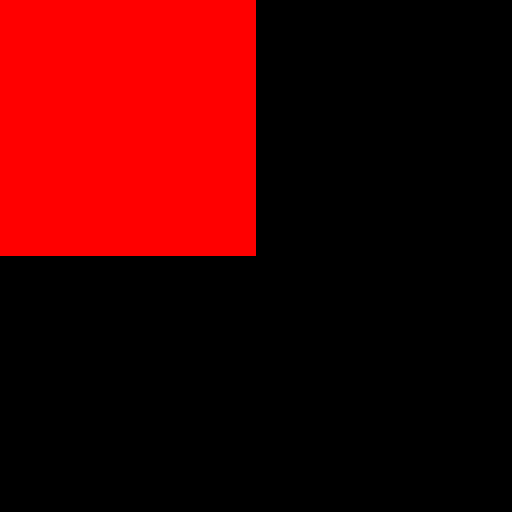

In [53]:
w, h = 512, 512
data = np.zeros((h, w, 3), dtype=np.uint8)
data[0:256, 0:256] = [255, 0, 0] # red patch in upper left
img = Image.fromarray(data, 'RGB')
img